In [3]:
import numpy as np
import pandas as pd

import seaborn as sns
import plotly.express as px 
import matplotlib.pyplot as plt
%matplotlib inline

from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
from sklearn.metrics import pairwise_distances
import warnings
warnings.filterwarnings("ignore")

In [4]:
data = pd.read_csv("data.csv")
genre_data = pd.read_csv('data_by_genres.csv')
year_data = pd.read_csv('data_by_year.csv')

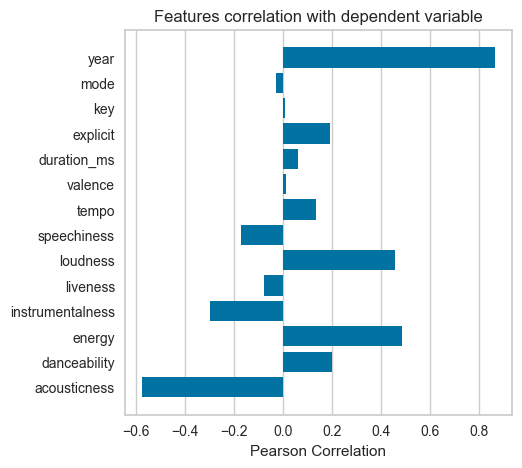

<Axes: title={'center': 'Features correlation with dependent variable'}, xlabel='Pearson Correlation'>

In [5]:

from yellowbrick.target import FeatureCorrelation

feature_names = ['acousticness', 'danceability', 'energy', 'instrumentalness', 'liveness', 'loudness', 'speechiness', 'tempo', 'valence', 'duration_ms', 'explicit', 'key', 'mode', 'year']

X, y = data[feature_names], data['popularity']

# Create a list of the feature names
features = np.array(feature_names)

# Instantiate the visualizer
visualizer = FeatureCorrelation(labels=features)

plt.rcParams['figure.figsize'] = (5, 5)
visualizer.fit(X, y)     # Fit the data to the visualizer
visualizer.show()

In [6]:
cluster_pipeline = Pipeline(
    [('scaler', StandardScaler()), ('kmeans', KMeans(n_clusters=10))])
X = genre_data.select_dtypes(np.number)
cluster_pipeline.fit(X)
genre_data['cluster'] = cluster_pipeline.predict(X)

In [7]:
tsne_pipeline = Pipeline(
    [('scaler', StandardScaler()), ('tsne', TSNE(n_components=2, verbose=1))])
genre_embedding = tsne_pipeline.fit_transform(X)
projection = pd.DataFrame(columns=['x', 'y'], data=genre_embedding)
projection['genres'] = genre_data['genres']
projection['cluster'] = genre_data['cluster']

fig = px.scatter(
    projection, x='x', y='y', color='cluster', hover_data=['x', 'y', 'genres'])

fig.show()

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 2973 samples in 0.003s...
[t-SNE] Computed neighbors for 2973 samples in 0.140s...
[t-SNE] Computed conditional probabilities for sample 1000 / 2973
[t-SNE] Computed conditional probabilities for sample 2000 / 2973
[t-SNE] Computed conditional probabilities for sample 2973 / 2973
[t-SNE] Mean sigma: 0.777516
[t-SNE] KL divergence after 250 iterations with early exaggeration: 76.106247
[t-SNE] KL divergence after 1000 iterations: 1.392991


In [8]:
song_cluster_pipeline = Pipeline([('scaler', StandardScaler()),('kmeans', KMeans(n_clusters=20, verbose=False))], verbose=False)

X = data.select_dtypes(np.number)
number_cols = list(X.columns)
song_cluster_pipeline.fit(X)
song_cluster_labels = song_cluster_pipeline.predict(X)
data['cluster_label'] = song_cluster_labels

In [9]:
pca_pipeline = Pipeline([('scaler', StandardScaler()),
                        ('PCA', PCA(n_components=2))])
song_embedding = pca_pipeline.fit_transform(X)
projection = pd.DataFrame(columns=['x', 'y'], data=song_embedding)
projection['title'] = data['name']
projection['cluster'] = data['cluster_label']

fig = px.scatter(
    projection, x='x', y='y', color='cluster', hover_data=['x', 'y', 'title'])
fig.show()

In [10]:
import spotipy
from spotipy.oauth2 import SpotifyClientCredentials
from collections import defaultdict

clientId = '114445a5b03f4ad9839ee3bb4b2d56ce'
clientSecret = 'e6ae322b1c8c4963bdb2dbb3cad9bf77'
sp = spotipy.Spotify(auth_manager=SpotifyClientCredentials(
    client_id=clientId, client_secret=clientSecret))


def find_song(name, year):
    song_data = defaultdict()
    results = sp.search(q='track: {} year: {}'.format(name, year), limit=1)
    if results['tracks']['items'] == []:
        return None

    results = results['tracks']['items'][0]
    track_id = results['id']
    audio_features = sp.audio_features(track_id)[0]

    song_data['name'] = [name]
    song_data['year'] = [year]
    song_data['explicit'] = [int(results['explicit'])]
    song_data['duration_ms'] = [results['duration_ms']]
    song_data['popularity'] = [results['popularity']]

    for key, value in audio_features.items():
        song_data[key] = value

    return pd.DataFrame(song_data)

In [11]:
def get_song_data(song, spotify_data):
    try:
        song_data = spotify_data[(spotify_data['name'] == song['name']) & (spotify_data['year'] == song['year'])].iloc[0]
        print('Fetching song information from local dataset')
        return song_data

    except IndexError:
        print('Fetching song information from spotify dataset')
        return find_song(song['name'], song['year'])


def get_mean_vector(song_list, spotify_data):
    song_vectors = []
    for song in song_list:
        song_data = get_song_data(song, spotify_data)
        if song_data is None:
            print('Warning: {} does not exist in Spotify or in database'.format(song['name']))
            continue
        song_vector = song_data[number_cols].values
        song_vectors.append(song_vector)

    # nd-array where n is number of songs in list. It contains all numerical vals of songs in sep list.
    song_matrix = np.array(list(song_vectors))
    # print(f'song_matrix {song_matrix}')
    return np.mean(song_matrix, axis=0)


def flatten_dict_list(dict_list):
    flattened_dict = defaultdict()
    for key in dict_list[0].keys():
        flattened_dict[key] = []  # 'name', 'year'
    for dic in dict_list:
        for key, value in dic.items():
            flattened_dict[key].append(value)  # creating list of values
    return flattened_dict

In [21]:
def recommend_songs(song_list, spotify_data, dist_algo='cosine', weight=None, n_songs=10):

    metadata_cols = ['name', 'year', 'artists']
    song_dict = flatten_dict_list(song_list)

    weight = [[]]

    song_center = get_mean_vector(song_list, spotify_data)
    scaler = song_cluster_pipeline.steps[0][1]
    scaled_data = scaler.transform(spotify_data[number_cols])
    scaled_song_center = scaler.transform(song_center.reshape(1, -1))
    print(scaled_song_center*[[1,1,1,1,1,1,1,1,1,1,1,1,1,1,1]])
    print(scaled_data[0])
    distances = pairwise_distances(
        scaled_song_center, scaled_data, metric=dist_algo)
    print(distances)
    index = list(np.argsort(distances)[:, :n_songs][0])
    print(index)

    rec_songs = spotify_data.iloc[index]
    rec_songs = rec_songs[~rec_songs['name'].isin(song_dict['name'])]
    return rec_songs[metadata_cols].to_dict(orient='records')

# Cosine

In [18]:
recommend_songs([{'name': 'Hotel Ceiling', 'year': 2014}], data, dist_algo="cosine")

Fetching song information from local dataset
[[-0.03642963  1.4358006  -0.91246495  0.66768662 -0.31907655  0.9288843
  -0.30395549 -0.53277054  1.36558797 -0.56542511  0.65076133  0.64391197
   1.30887401 -0.42026197 -0.38541809]]
[-1.7828247  -2.15247016  1.27618658 -1.46701268  4.76314621 -1.01398836
 -0.30395549  2.2681019   1.36558797  2.6267188  -1.51423687  0.64391197
 -1.25680847 -0.37970638 -1.16930675]
[[1.43040509 1.22513395 1.61133012 ... 0.38342023 0.76800574 0.40185936]]
[74037, 124905, 140700, 36445, 37339, 155070, 124779, 37766, 55173, 91720]


[{'name': 'Gabrielle', 'year': 2020, 'artists': "['Brett Eldredge']"},
 {'name': 'We Go Together Like', 'year': 2020, 'artists': "['Abby Anderson']"},
 {'name': 'Crazy for You', 'year': 2009, 'artists': "['Madonna']"},
 {'name': 'Back Home', 'year': 2014, 'artists': "['Andy Grammer']"},
 {'name': 'Wonder Woman', 'year': 2018, 'artists': "['Kacey Musgraves']"},
 {'name': 'Good Die Young', 'year': 2020, 'artists': "['Koe Wetzel']"},
 {'name': 'Dark Days', 'year': 2016, 'artists': "['Local Natives']"},
 {'name': 'El Amor', 'year': 2009, 'artists': '[\'Tito "El Bambino"\']'},
 {'name': 'Saltwater Gospel', 'year': 2017, 'artists': "['Eli Young Band']"}]

# Euclidean

In [19]:
recommend_songs([{'name': 'Hotel Ceiling', 'year': 2014}], data, dist_algo="euclidean")

Fetching song information from local dataset
[[-0.03642963  1.4358006  -0.91246495  0.66768662 -0.31907655  0.9288843
  -0.30395549 -0.53277054  1.36558797 -0.56542511  0.65076133  0.64391197
   1.30887401 -0.42026197 -0.38541809]]
[-1.7828247  -2.15247016  1.27618658 -1.46701268  4.76314621 -1.01398836
 -0.30395549  2.2681019   1.36558797  2.6267188  -1.51423687  0.64391197
 -1.25680847 -0.37970638 -1.16930675]
[[9.20853957 6.04515602 7.41913816 ... 3.28600025 5.90214891 4.05028185]]
[74037, 36445, 37766, 124905, 155070, 55173, 18561, 169844, 37339, 91720]


[{'name': 'Crazy for You', 'year': 2009, 'artists': "['Madonna']"},
 {'name': 'Dark Days', 'year': 2016, 'artists': "['Local Natives']"},
 {'name': 'Gabrielle', 'year': 2020, 'artists': "['Brett Eldredge']"},
 {'name': 'Wonder Woman', 'year': 2018, 'artists': "['Kacey Musgraves']"},
 {'name': 'El Amor', 'year': 2009, 'artists': '[\'Tito "El Bambino"\']'},
 {'name': 'Sangria', 'year': 2014, 'artists': "['Blake Shelton']"},
 {'name': 'I Believe in You', 'year': 2016, 'artists': "['Michael Bublé']"},
 {'name': 'Back Home', 'year': 2014, 'artists': "['Andy Grammer']"},
 {'name': 'Saltwater Gospel', 'year': 2017, 'artists': "['Eli Young Band']"}]

# Manhattan

In [20]:
recommend_songs([{'name': 'Hotel Ceiling', 'year': 2014}], data, dist_algo="manhattan")

Fetching song information from local dataset
[[-0.03642963  1.4358006  -0.91246495  0.66768662 -0.31907655  0.9288843
  -0.30395549 -0.53277054  1.36558797 -0.56542511  0.65076133  0.64391197
   1.30887401 -0.42026197 -0.38541809]]
[-1.7828247  -2.15247016  1.27618658 -1.46701268  4.76314621 -1.01398836
 -0.30395549  2.2681019   1.36558797  2.6267188  -1.51423687  0.64391197
 -1.25680847 -0.37970638 -1.16930675]
[[28.23125335 17.56767701 22.86330499 ...  8.81007715 15.69808087
   8.79468724]]
[74037, 36445, 169844, 155070, 55173, 124905, 73625, 16129, 18561, 73918]


[{'name': 'Crazy for You', 'year': 2009, 'artists': "['Madonna']"},
 {'name': 'I Believe in You', 'year': 2016, 'artists': "['Michael Bublé']"},
 {'name': 'Wonder Woman', 'year': 2018, 'artists': "['Kacey Musgraves']"},
 {'name': 'El Amor', 'year': 2009, 'artists': '[\'Tito "El Bambino"\']'},
 {'name': 'Gabrielle', 'year': 2020, 'artists': "['Brett Eldredge']"},
 {'name': 'Bit By Bit', 'year': 2012, 'artists': "['Mother Mother']"},
 {'name': 'Brokenheartsville', 'year': 2002, 'artists': "['Joe Nichols']"},
 {'name': 'Sangria', 'year': 2014, 'artists': "['Blake Shelton']"},
 {'name': 'Kids Again', 'year': 2014, 'artists': "['Artist Vs Poet']"}]